# Metodología de Control de Calidad e Imputación de Datos de Series de Precipitación In Situ

## Objetivo
Esta metodología tiene como finalidad establecer un proceso robusto para la imputación de datos de precipitación in situ, utilizando técnicas modernas de Big Data y Machine Learning, complementadas con datos satelitales y bases de datos climáticas globales (como CHIRPS, ERA5, entre otras).

## 1. Preprocesamiento y Estandarización de Datos
Antes de aplicar cualquier proceso de control de calidad o imputación, es fundamental garantizar la correcta estructuración de los datos brutos o primarios.

La estructura base de una serie de datos estandarizada será:

| Index       | value |
|-------------|--------|
| 2020-01-01  | 2.53   |

- Index: tipo datetime, correspondiente a la fecha y hora de la observación.

- value: valor numérico registrado (precipitación en mm, por ejemplo).

Esta estructura debe representarse como una `pandas.Series` o un `pandas.DataFrame`, con índice tipo `datetime`.

## 2. Estructura de Control de Calidad
A partir de la serie estandarizada, se genera una estructura de control de calidad que enriquece la serie con metadatos asociados al resultado de las pruebas de calidad:

| Index       | value | qf | dp    |
|-------------|-------|----|-------|
| 2020-01-01  | 2.53  | 1  | 22358 |

- **qf (Quality Flag)**: código numérico que indica el resultado de una o varias pruebas de calidad.

- **dp (Descriptor de Proceso)**: identificador del proceso o técnica aplicada (detección, interpolación, imputación, etc.).

> ⚠️ La preservación de los datos originales es una prioridad. Las modificaciones solo deben aplicarse cuando la prueba indique una necesidad clara y bien justificada.

## 3. Pruebas de Control de Calidad
### 3.1. Consistencia Temporal
Una serie temporal debe tener frecuencia de muestreo constante. Esto significa que cada paso de tiempo entre observaciones debe ser homogéneo (e.g., diaria, horaria).

Proceso:
- Se analiza la frecuencia de muestreo mediante pandas.infer_freq o análisis de diferencias del índice.

- Si se detectan huecos en la serie (días u horas faltantes), se reindexa la serie para completar la malla temporal esperada.

    `df = df.asfreq('D')  # ejemplo para series diarias`
- A los puntos sin datos se les asigna un valor por defecto de -99999, conforme a estándares internacionales como los del IODE (International Oceanographic Data and Information Exchange).
    `df['value'].fillna(-99999, inplace=True)`

### 3.2. Otras Pruebas Básicas
- Rango Físico Aceptable: verifica que los valores estén dentro del rango físico o esperable (e.g., precipitación no puede ser negativa).

- Detección de valores extremos/anómalos: puede utilizarse el IQR, desviaciones estándar, o algoritmos robustos como Isolation Forest.

- Duplicados temporales: detección y resolución de registros con el mismo timestamp.

- Coherencia contextual: análisis de coherencia con estaciones vecinas o datos satelitales.

## 4. Imputación de Datos Faltantes
Una vez aplicada la batería de pruebas de calidad y etiquetados los valores anómalos o faltantes, se procede con la imputación de datos.

### 4.1. Fuentes de Información para la Imputación
- Estaciones vecinas (in situ).

- Datos satelitales (e.g., CHIRPS, GPM).

- Reanálisis climáticos (e.g., ERA5).

- Modelos estadísticos o de machine learning.

### 4.2. Técnicas de Imputación
- Interpolación temporal: lineal, spline, polinómica.

- K-Nearest Neighbors (KNN).

- Modelos de regresión multivariable (MLR).

- Redes neuronales (RNN, LSTM) para imputaciones complejas.

- Random Forest para variables con relaciones no lineales.

- La técnica aplicada se documenta en la columna dp, permitiendo rastrear el origen de cada dato imputado.

## 5. Estándares y Buenas Prácticas
- Trazabilidad: Toda modificación o imputación debe estar documentada y trazable.

- Conservación de Datos Originales: Mantener una copia sin modificar de la serie original.

- Reproducibilidad: Los scripts de calidad deben ser modulares y versionados.

- Evaluación Continua: Los algoritmos de imputación deben ser validados periódicamente frente a nuevas entradas de datos.

```
import pandas as pd

# Serie original
data = {'value': [2.53, 3.0, None, 2.1]}
index = pd.date_range(start='2020-01-01', periods=4, freq='D')
df = pd.DataFrame(data, index=index)

# Estructura de calidad
df['qf'] = [1, 1, 9, 1]  # 9 indica dato faltante
df['dp'] = [22358, 22358, 99999, 22358]
```
7. Resultados Esperados
- Series de precipitación limpias, consistentes, completas y trazables.

- Imputaciones realizadas con soporte técnico y científico.

- Alineación con estándares internacionales (WMO, IODE, etc.).

- Base sólida para análisis hidrometeorológicos, climatológicos o de gestión del recurso hídrico.

# Serie Somo

INFO:api_somo:Sending request to http://127.0.0.1:8000/database/functions/time-series/filter_date_serie/ with parameters: {'station_name': 'tumaco', 'variable_name': 'Precipitación acumulada', 'processing_level_name': 'Control de calidad', 'start_date': '2009-01-01', 'end_date': '2023-12-31'}
INFO:api_somo:Original columns: ['date_time', 'sensor_data', 'quality_flag']
INFO:api_somo:Timestamp conversion and indexing complete.


Reporte de datos NaN por columna:
value    29717
dtype: int64


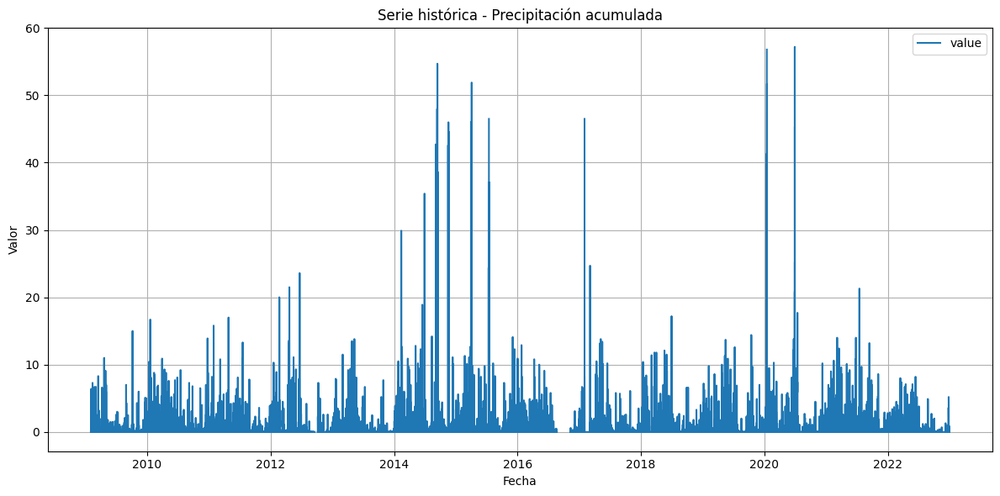

In [1]:
from api_somo import APIClient, fetch_qf 
import logging
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Configuración del logger
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

api_url = "http://127.0.0.1:8000/database/functions/time-series/filter_date_serie/"
params = {
    "station_name": "tumaco",
    "variable_name": "Precipitación acumulada",
    "processing_level_name": "Control de calidad",
    "start_date": "2009-01-01",
    "end_date": "2023-12-31"
}

try:
    # 1. Solicitar y procesar los datos
    red_mpomm_serie, red_mpomm_metadata = APIClient.fetch_and_process_data(api_url, params)

    # Asegurar que el índice es datetime
    if not pd.api.types.is_datetime64_any_dtype(red_mpomm_serie.index):
        red_mpomm_serie.index = pd.to_datetime(red_mpomm_serie.index)

    if red_mpomm_serie.empty:
        raise ValueError("La serie histórica está vacía.")

    #logger.info(f"Serie histórica descargada correctamente. Columnas: {red_mpomm_serie.columns.tolist()}")

except Exception as e:
    logger.error(f"Error al obtener la serie histórica: {e}")
    red_mpomm_serie = pd.DataFrame()  # para evitar errores en siguientes pasos

# --- PROCESAMIENTO: FILTRAR CALIDAD ---
if not red_mpomm_serie.empty:
    # QF: Solo valores con calidad 1 o 3 son aceptados
    red_mpomm_serie.loc[~red_mpomm_serie['qf'].isin([1, 3])] = np.nan
    red_mpomm_serie = red_mpomm_serie.drop(columns='qf')

    # Reporte de NaNs
    print('Reporte de datos NaN por columna:')
    print(red_mpomm_serie.isnull().sum())
    
    # --- GRAFICAR ---
    plt.figure(figsize=(12, 6))
    plt.plot(red_mpomm_serie, label=red_mpomm_serie.columns[0])
    plt.xlabel('Fecha')
    plt.ylabel('Valor')
    plt.title('Serie histórica - Precipitación acumulada')
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Mostrar primeras filas
    red_mpomm_serie

Reporte de datos NaN y/o null en la serie actual: 
value    1845
dtype: int64 



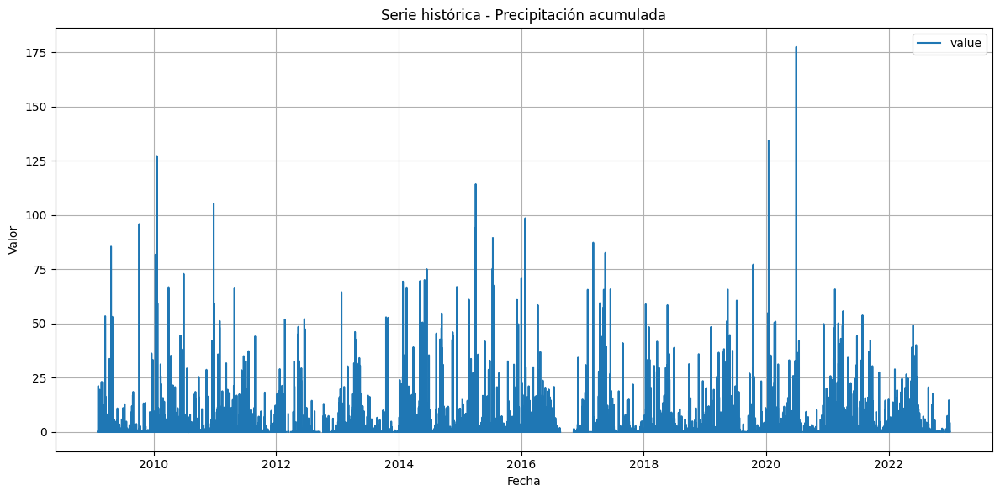

In [2]:
# Remuestreo condicional

# Función para eliminar grupos con más de un porcentaje de NaN
def custom_resample(group, nan_threshold=0.2):
    nan_ratio = group.isna().sum() / len(group)
    return group.sum() if nan_ratio < nan_threshold else np.nan

# Resampleo con diferentes períodos de agregación
red_mpomm_serie_3h = red_mpomm_serie.resample('3h').apply(lambda g: custom_resample(g, nan_threshold=0.2))
print('Reporte de datos NaN y/o null en la serie actual: ')
print(red_mpomm_serie_3h.isnull().sum(),'\n')

# --- GRAFICAR ---
plt.figure(figsize=(12, 6))
plt.plot(red_mpomm_serie_3h, label=red_mpomm_serie_3h.columns[0])
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Serie histórica - Precipitación acumulada')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# Serie MSWEB

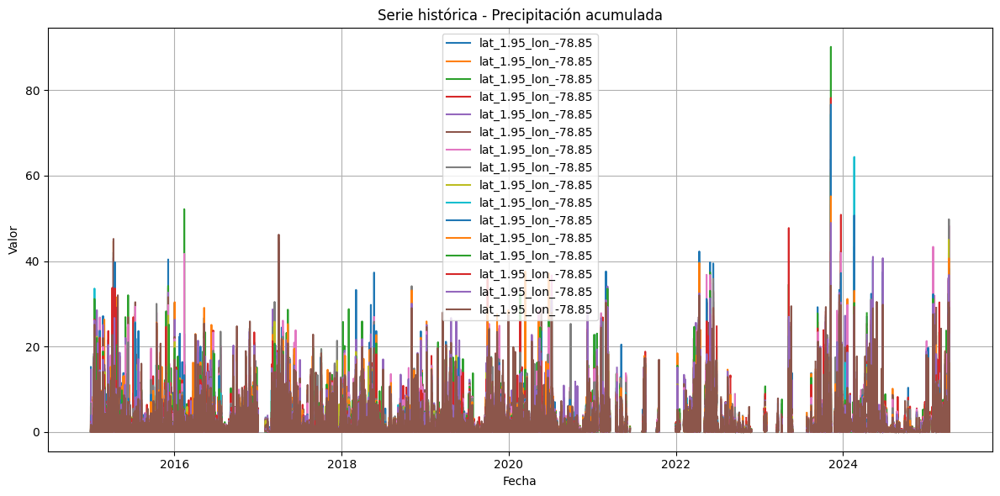

Reporte de datos NaN por columna:
lat_1.95_lon_-78.85    6392
lat_1.95_lon_-78.75    6392
lat_1.95_lon_-78.65    6392
lat_1.95_lon_-78.55    6392
lat_1.85_lon_-78.85    6392
lat_1.85_lon_-78.75    6392
lat_1.85_lon_-78.65    6392
lat_1.85_lon_-78.55    6392
lat_1.75_lon_-78.85    6392
lat_1.75_lon_-78.75    6392
lat_1.75_lon_-78.65    6392
lat_1.75_lon_-78.55    6392
lat_1.65_lon_-78.85    6392
lat_1.65_lon_-78.75    6392
lat_1.65_lon_-78.65    6392
lat_1.65_lon_-78.55    6392
dtype: int64


,lat_1.95_lon_-78.85,lat_1.95_lon_-78.75,lat_1.95_lon_-78.65,lat_1.95_lon_-78.55,lat_1.85_lon_-78.85,lat_1.85_lon_-78.75,lat_1.85_lon_-78.65,lat_1.85_lon_-78.55,lat_1.75_lon_-78.85,lat_1.75_lon_-78.75,lat_1.75_lon_-78.65,lat_1.75_lon_-78.55,lat_1.65_lon_-78.85,lat_1.65_lon_-78.75,lat_1.65_lon_-78.65,lat_1.65_lon_-78.55
2015-01-01 00:00:00,0.125000,0.062500,0.062500,0.312500,0.125000,0.125000,0.062500,0.250000,0.062500,0.125000,0.062500,0.187500,0.125000,0.125000,0.062500,0.187500
2015-01-01 03:00:00,0.625000,0.625000,0.562500,0.437500,0.562500,0.625000,0.500000,0.812500,0.500000,0.375000,0.375000,0.625000,0.437500,0.375000,0.375000,0.687500
2015-01-01 06:00:00,0.812500,5.937500,4.375000,0.937500,1.062500,0.625000,6.187500,1.937500,0.375000,0.500000,0.562500,0.500000,0.375000,0.562500,0.375000,0.312500
2015-01-01 09:00:00,15.250000,4.500000,5.750000,4.312500,14.625000,6.125000,4.562500,6.750000,2.312500,1.937500,3.812500,1.937500,0.812500,2.437500,1.000000,1.125000
2015-01-01 12:00:00,0.125000,2.437500,3.437500,2.062500,0.437500,2.437500,2.250000,3.562500,0.875000,0.625000,1.937500,2.250000,0.375000,0.250000,0.375000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-04-10 03:00:00,2.341543,2.368103,2.450322,4.001059,3.961223,4.144755,4.344019,4.816211,3.467693,3.455798,3.550281,4.723328,3.667368,3.607772,3.837389,4.666706
2025-04-10 06:00:00,1.648807,1.696712,1.721477,1.075704,1.983645,2.148014,2.185470,1.485247,1.677693,1.676899,1.821256,1.425534,1.759375,1.765851,1.893882,1.430813
2025-04-10 09:00:00,2.502083,1.976913,2.050413,1.323445,2.197865,1.783330,1.831183,1.049082,1.374872,1.390130,1.518427,0.995285,1.458750,1.472201,1.573823,0.999649
2025-04-10 12:00:00,1.961866,2.006043,2.080252,1.643980,1.231471,1.372182,1.387669,0.623440,1.017644,1.033707,1.137770,0.588425,1.077361,1.090197,1.148927,0.587019


In [3]:
import pandas as pd

# Cargar el CSV y parsear la columna de fecha como datetime
mswep_serie = pd.read_csv(
    r"E:\074-Diego Rengifo 2025\datasience\precipitacion\db\MSWEP-GloH2O\csv-3h\precipitacion radius(1.82011, -78.72871).csv",
    parse_dates=['dates'],   # reemplaza 'datetime' con el nombre real de tu columna de fecha
    index_col='dates'        # establecer la columna como índice
)



# --- Preprocesamiento: Agregacion temporal ---
if not mswep_serie.empty:
    mswep_serie.index= pd.to_datetime(mswep_serie.index)

    # Paso 2: Crear una serie con índice completo con frecuencia cada 3 horas
    start = mswep_serie.index.min()
    end = mswep_serie.index.max()
    full_index = pd.date_range(start=start, end=end, freq='3h')

    # Paso 3: Reindexar para insertar NaN donde faltan datos
    mswep_serie_with_nans = mswep_serie.reindex(full_index)
    
    # --- GRAFICAR ---
    plt.figure(figsize=(12, 6))
    plt.plot(mswep_serie_with_nans, label=mswep_serie.columns[0])
    plt.xlabel('Fecha')
    plt.ylabel('Valor')
    plt.title('Serie histórica - Precipitación acumulada')
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Reporte de NaNs
print('Reporte de datos NaN por columna:')
print(mswep_serie_with_nans.isnull().sum())
mswep_serie_with_nans



# Dataset

In [4]:
# Convertir las series a DataFrames (si no lo son ya)
from operator import index


serie_red = red_mpomm_serie_3h['value'].to_frame()
serie_red.index = pd.to_datetime(serie_red.index).tz_localize(None)
serie_mswep = mswep_serie_with_nans.copy()
serie_mswep.index = pd.to_datetime(serie_mswep.index).tz_localize(None)

# Hacer un left join para mantener todos los datos de red_mpomm_serie_3h
dataset = serie_red.join(serie_mswep, how="left")

# Asegurar que el índice no tiene zona horaria
dataset.index = pd.to_datetime(dataset.index).tz_localize(None)

# Reporte de NaNs
print('Reporte de datos NaN por columna:')
print(dataset.isnull().sum())

# Mostrar primeras filas
dataset


Reporte de datos NaN por columna:
value                   1845
lat_1.95_lon_-78.85    20783
lat_1.95_lon_-78.75    20783
lat_1.95_lon_-78.65    20783
lat_1.95_lon_-78.55    20783
lat_1.85_lon_-78.85    20783
lat_1.85_lon_-78.75    20783
lat_1.85_lon_-78.65    20783
lat_1.85_lon_-78.55    20783
lat_1.75_lon_-78.85    20783
lat_1.75_lon_-78.75    20783
lat_1.75_lon_-78.65    20783
lat_1.75_lon_-78.55    20783
lat_1.65_lon_-78.85    20783
lat_1.65_lon_-78.75    20783
lat_1.65_lon_-78.65    20783
lat_1.65_lon_-78.55    20783
dtype: int64


,value,lat_1.95_lon_-78.85,lat_1.95_lon_-78.75,lat_1.95_lon_-78.65,lat_1.95_lon_-78.55,lat_1.85_lon_-78.85,lat_1.85_lon_-78.75,lat_1.85_lon_-78.65,lat_1.85_lon_-78.55,lat_1.75_lon_-78.85,lat_1.75_lon_-78.75,lat_1.75_lon_-78.65,lat_1.75_lon_-78.55,lat_1.65_lon_-78.85,lat_1.65_lon_-78.75,lat_1.65_lon_-78.65,lat_1.65_lon_-78.55
timestamp,,,,,,,,,,,,,,,,,
2009-02-01 03:00:00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-02-01 06:00:00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-02-01 09:00:00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-02-01 12:00:00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-02-01 15:00:00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 15:00:00,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-12-31 18:00:00,0.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-12-31 21:00:00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
# Encuentra el primer índice con dato no nulo en precipitation
start_index = dataset['lat_1.95_lon_-78.85'].first_valid_index()

# Filtra el DataFrame desde ese índice en adelante
filtered_dataset = dataset.loc[start_index:]

# Verifica resultado
print(f"Primer dato válido de precipitation: {start_index}")
print(filtered_dataset.head())


Primer dato válido de precipitation: 2015-01-01 00:00:00
                     value  lat_1.95_lon_-78.85  lat_1.95_lon_-78.75  \
timestamp                                                              
2015-01-01 00:00:00    0.0               0.1250               0.0625   
2015-01-01 03:00:00    0.0               0.6250               0.6250   
2015-01-01 06:00:00    0.0               0.8125               5.9375   
2015-01-01 09:00:00    0.2              15.2500               4.5000   
2015-01-01 12:00:00    4.7               0.1250               2.4375   

                     lat_1.95_lon_-78.65  lat_1.95_lon_-78.55  \
timestamp                                                       
2015-01-01 00:00:00               0.0625               0.3125   
2015-01-01 03:00:00               0.5625               0.4375   
2015-01-01 06:00:00               4.3750               0.9375   
2015-01-01 09:00:00               5.7500               4.3125   
2015-01-01 12:00:00               3.4375        

In [6]:
dataset.describe()

,value,lat_1.95_lon_-78.85,lat_1.95_lon_-78.75,lat_1.95_lon_-78.65,lat_1.95_lon_-78.55,lat_1.85_lon_-78.85,lat_1.85_lon_-78.75,lat_1.85_lon_-78.65,lat_1.85_lon_-78.55,lat_1.75_lon_-78.85,lat_1.75_lon_-78.75,lat_1.75_lon_-78.65,lat_1.75_lon_-78.55,lat_1.65_lon_-78.85,lat_1.65_lon_-78.75,lat_1.65_lon_-78.65,lat_1.65_lon_-78.55
count,38812.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000,19874.000000
mean,0.861581,1.130384,1.171406,1.167368,1.165118,1.169731,1.230095,1.251368,1.192092,0.916921,0.921703,1.009134,1.127283,0.930833,0.953485,1.020386,1.122380
std,4.465109,2.443629,2.519762,2.533186,2.234928,2.568875,2.510740,2.607190,2.278776,1.937224,1.928448,2.155709,2.219502,1.977878,2.073308,2.243787,2.279300
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.062500,0.062500,0.062500,0.125000,0.062500,0.125000,0.117647,0.125000,0.062500,0.062500,0.062500,0.125000,0.062500,0.062500,0.062500,0.125000
50%,0.000000,0.312500,0.312500,0.312500,0.375000,0.312500,0.375000,0.375000,0.375000,0.250000,0.250000,0.250000,0.375000,0.250000,0.250000,0.250000,0.319302
75%,0.000000,1.062500,1.125000,1.062500,1.187500,1.094197,1.187500,1.187500,1.207216,0.875000,0.875000,0.946620,1.125000,0.875000,0.877209,0.937500,1.125000
max,177.600000,42.062500,44.625000,52.125000,35.750000,40.812500,45.187500,41.687500,35.834939,30.671999,33.562500,42.252767,39.573894,33.536433,33.750000,44.437500,46.187500


# Grafica

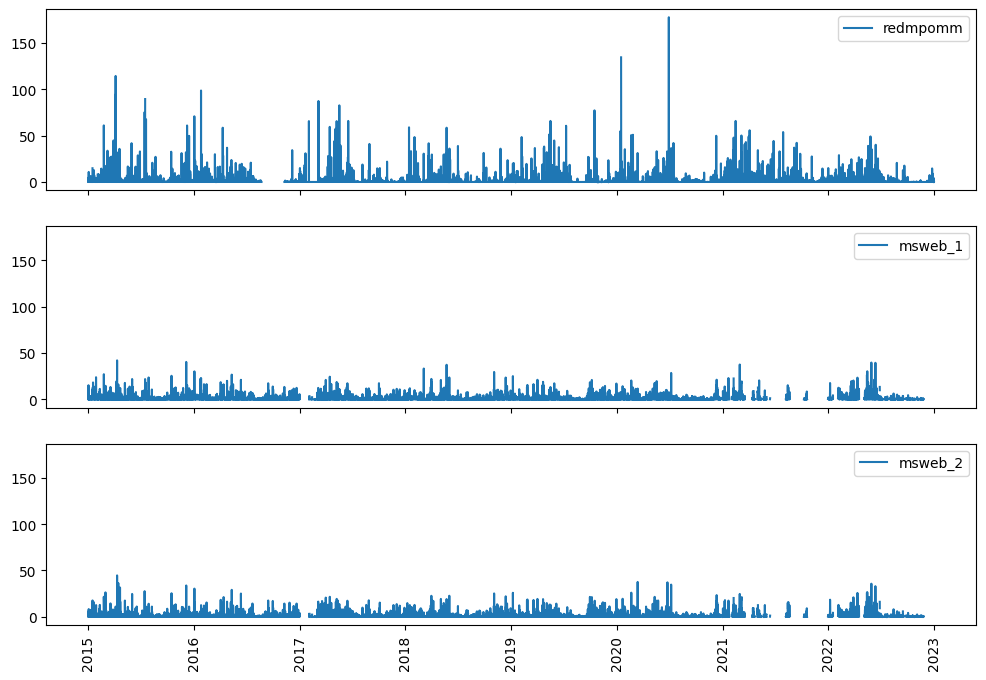

In [7]:
fig, axs=plt.subplots(3,1,figsize=(12,8),sharex=True,sharey=True)
axs[0].plot(filtered_dataset.index,filtered_dataset['value'],label='redmpomm')
axs[0].legend()
axs[1].plot(filtered_dataset.index,filtered_dataset['lat_1.95_lon_-78.85'],label='msweb_1')
axs[1].legend()
axs[2].plot(filtered_dataset.index,filtered_dataset['lat_1.95_lon_-78.75'],label='msweb_2')
axs[2].legend()
plt.xticks(rotation='vertical')
plt.show()

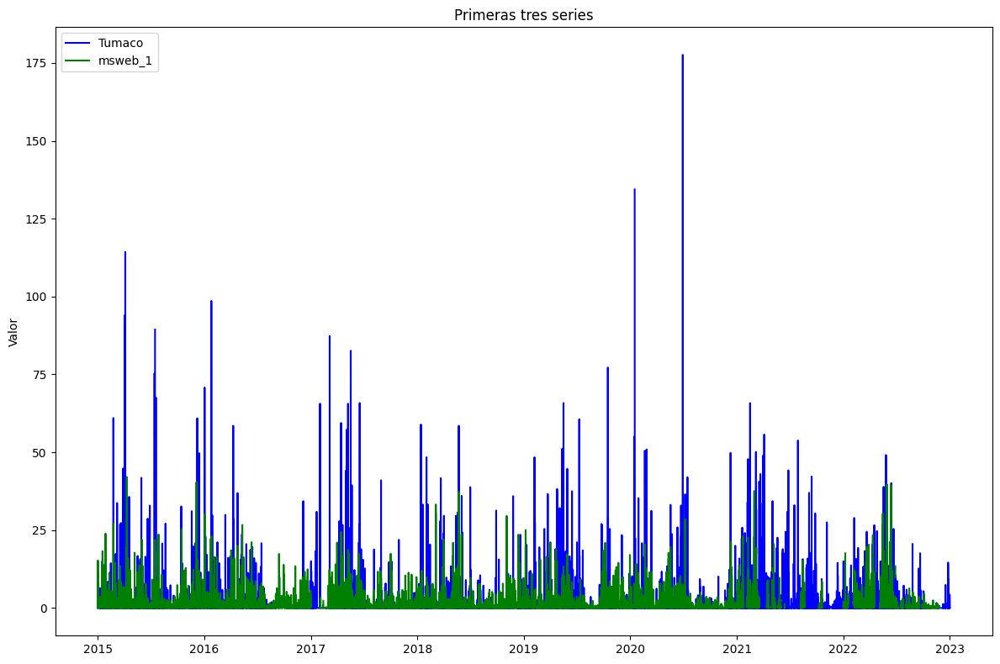

In [8]:
import matplotlib.pyplot as plt

# Crear la figura y el eje
fig, ax = plt.subplots(figsize=(12, 8), sharex=True)

# Graficar las tres primeras series en el mismo subplot
ax.plot(filtered_dataset.index, filtered_dataset['value'], label="Tumaco", color="blue")
ax.plot(filtered_dataset.index, filtered_dataset['lat_1.95_lon_-78.85'], label="msweb_1", color="green")


# Configurar título y etiquetas
ax.set_title('Primeras tres series')
ax.set_ylabel('Valor')
ax.legend(loc='upper left')

# Ajustar diseño y mostrar
plt.tight_layout()
plt.show()


In [9]:
import plotly.express as px
import calendar

fig = px.box(filtered_dataset)

fig.show()

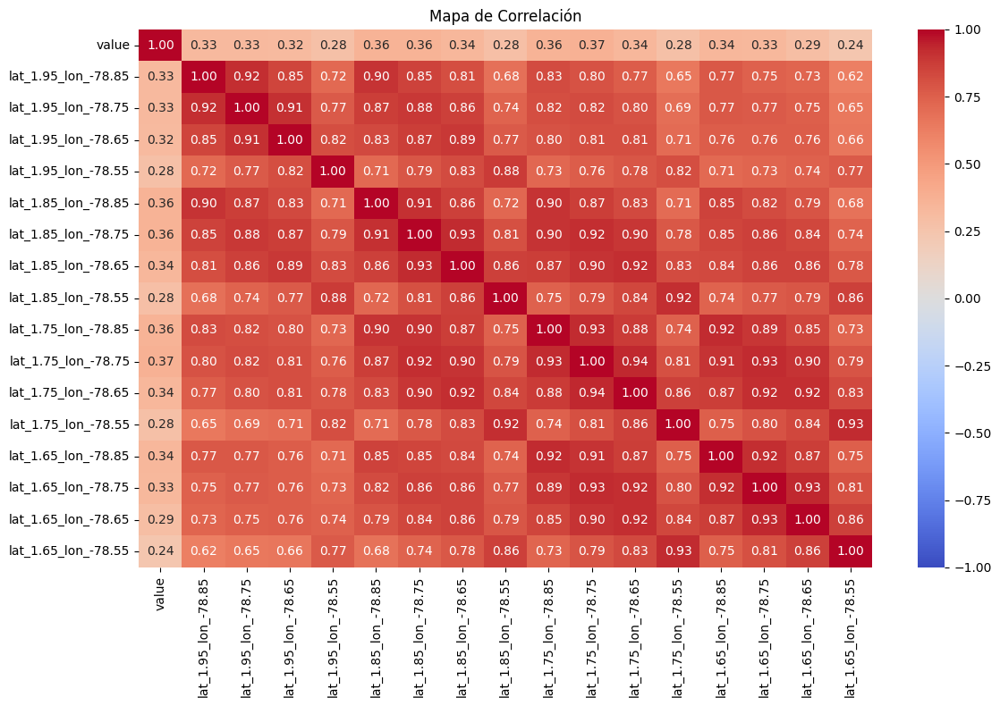

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calcular la matriz de correlación
correlation_matrix = filtered_dataset.corr()

# Crear el mapa de calor
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, fmt=".2f")

# Título y ajustes
plt.title("Mapa de Correlación")
plt.tight_layout()
plt.show()


In [11]:
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor


In [12]:
precipNotNan = filtered_dataset.dropna()
print('Reporte de datos NaN por columna:')
print(precipNotNan.isnull().sum())
precipNotNan


Reporte de datos NaN por columna:
value                  0
lat_1.95_lon_-78.85    0
lat_1.95_lon_-78.75    0
lat_1.95_lon_-78.65    0
lat_1.95_lon_-78.55    0
lat_1.85_lon_-78.85    0
lat_1.85_lon_-78.75    0
lat_1.85_lon_-78.65    0
lat_1.85_lon_-78.55    0
lat_1.75_lon_-78.85    0
lat_1.75_lon_-78.75    0
lat_1.75_lon_-78.65    0
lat_1.75_lon_-78.55    0
lat_1.65_lon_-78.85    0
lat_1.65_lon_-78.75    0
lat_1.65_lon_-78.65    0
lat_1.65_lon_-78.55    0
dtype: int64


,value,lat_1.95_lon_-78.85,lat_1.95_lon_-78.75,lat_1.95_lon_-78.65,lat_1.95_lon_-78.55,lat_1.85_lon_-78.85,lat_1.85_lon_-78.75,lat_1.85_lon_-78.65,lat_1.85_lon_-78.55,lat_1.75_lon_-78.85,lat_1.75_lon_-78.75,lat_1.75_lon_-78.65,lat_1.75_lon_-78.55,lat_1.65_lon_-78.85,lat_1.65_lon_-78.75,lat_1.65_lon_-78.65,lat_1.65_lon_-78.55
timestamp,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,0.0,0.125000,0.062500,0.062500,0.312500,0.125000,0.125000,0.062500,0.250000,0.062500,0.125000,0.062500,0.187500,0.125000,0.125000,0.062500,0.187500
2015-01-01 03:00:00,0.0,0.625000,0.625000,0.562500,0.437500,0.562500,0.625000,0.500000,0.812500,0.500000,0.375000,0.375000,0.625000,0.437500,0.375000,0.375000,0.687500
2015-01-01 06:00:00,0.0,0.812500,5.937500,4.375000,0.937500,1.062500,0.625000,6.187500,1.937500,0.375000,0.500000,0.562500,0.500000,0.375000,0.562500,0.375000,0.312500
2015-01-01 09:00:00,0.2,15.250000,4.500000,5.750000,4.312500,14.625000,6.125000,4.562500,6.750000,2.312500,1.937500,3.812500,1.937500,0.812500,2.437500,1.000000,1.125000
2015-01-01 12:00:00,4.7,0.125000,2.437500,3.437500,2.062500,0.437500,2.437500,2.250000,3.562500,0.875000,0.625000,1.937500,2.250000,0.375000,0.250000,0.375000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-25 21:00:00,0.0,0.010713,0.010772,0.010855,0.072824,0.003150,0.003197,0.003303,0.158481,0.003166,0.003162,0.003191,0.143397,0.003136,0.003141,0.003268,0.142198
2022-11-26 03:00:00,0.0,0.089401,0.091005,0.091244,0.163856,0.066818,0.071006,0.072961,0.334455,0.061317,0.061656,0.063971,0.315875,0.061589,0.061092,0.064318,0.310934
2022-11-26 09:00:00,0.0,0.468541,0.485616,0.481585,0.381236,0.351868,0.389140,0.395843,0.546286,0.292781,0.295678,0.315047,0.522482,0.298920,0.295905,0.309253,0.515365


In [13]:
xTrain = precipNotNan[['lat_1.95_lon_-78.85','lat_1.95_lon_-78.75']]
yTrain = precipNotNan[['value']].values.flatten()
print(xTrain[:10])
print(yTrain[:10])

                     lat_1.95_lon_-78.85  lat_1.95_lon_-78.75
timestamp                                                    
2015-01-01 00:00:00               0.1250               0.0625
2015-01-01 03:00:00               0.6250               0.6250
2015-01-01 06:00:00               0.8125               5.9375
2015-01-01 09:00:00              15.2500               4.5000
2015-01-01 12:00:00               0.1250               2.4375
2015-01-01 15:00:00               0.5625               0.3750
2015-01-01 18:00:00               0.1250               0.1250
2015-01-01 21:00:00               0.0625               0.0625
2015-01-02 00:00:00               0.1875               0.1875
2015-01-02 03:00:00               0.3125               0.3125
[0.  0.  0.  0.2 4.7 0.1 0.  0.  0.  0. ]


In [14]:
scaler = StandardScaler().fit(xTrain.values)
xTrainScaled = scaler.transform(xTrain.values)
print(xTrainScaled[:10])

[[-0.41187542 -0.43970574]
 [-0.20828716 -0.21779002]
 [-0.13194157  1.87808067]
 [ 5.74666937  1.31096272]
 [-0.41187542  0.49727174]
 [-0.23373569 -0.31641923]
 [-0.41187542 -0.41504844]
 [-0.43732395 -0.43970574]
 [-0.38642689 -0.39039114]
 [-0.33552982 -0.34107653]]


In [15]:
#check scaler
print(xTrainScaled.mean(axis=0))
print(xTrainScaled.std(axis=0))

[-5.23144796e-18  2.54098901e-17]
[1. 1.]


In [ ]:
#regressor
regr = MLPRegressor(
    hidden_layer_sizes=(100, 50),  # Capas ocultas: una capa con 100 neuronas (por defecto)
    activation='relu',          # Función de activación: 'relu', 'tanh', 'logistic'
    solver='adam',              # Optimizador: 'adam', 'sgd', 'lbfgs', 'identity'
    alpha=0.01,               # Tasa de regularización (evita overfitting)
    batch_size='auto',          # Tamaño de lote para entrenamiento
    learning_rate='constant',   # Tasa de aprendizaje: 'constant', 'invscaling', 'adaptive'
    max_iter=5000,               # Número máximo de iteraciones (épocas)
    early_stopping=False,
    random_state=1              # Reproducibilidad
).fit(xTrainScaled, yTrain)
#test
xTest = filtered_dataset[['lat_1.95_lon_-78.85','lat_1.95_lon_-78.75']].dropna()
xTestScaled = scaler.transform(xTest.values)
print(xTest.describe())
print(xTestScaled[:10])

       lat_1.95_lon_-78.85  lat_1.95_lon_-78.75
count         19874.000000         19874.000000
mean              1.130384             1.171406
std               2.443629             2.519762
min               0.000000             0.000000
25%               0.062500             0.062500
50%               0.312500             0.312500
75%               1.062500             1.125000
max              42.062500            44.625000
[[-0.41187542 -0.43970574]
 [-0.20828716 -0.21779002]
 [-0.13194157  1.87808067]
 [ 5.74666937  1.31096272]
 [-0.41187542  0.49727174]
 [-0.23373569 -0.31641923]
 [-0.41187542 -0.41504844]
 [-0.43732395 -0.43970574]
 [-0.38642689 -0.39039114]
 [-0.33552982 -0.34107653]]


In [30]:
import pandas as pd

xTrain_df = pd.DataFrame(xTrain)
yTrain_series = pd.Series(yTrain)

print(xTrain_df.shape, type(xTrain_df))
print(yTrain_series.shape, type(yTrain_series))
print(xTrain_df.isnull().sum().sum(), yTrain_series.isnull().sum())


(19015, 2) <class 'pandas.core.frame.DataFrame'>
(19015,) <class 'pandas.core.series.Series'>
0 0


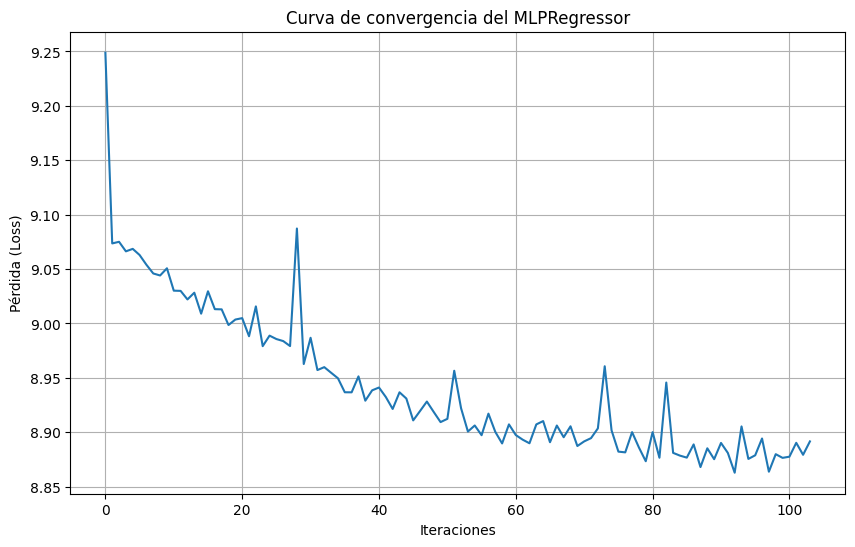

In [31]:
import matplotlib.pyplot as plt

# Graficar la pérdida por iteración
plt.figure(figsize=(10, 6))
plt.plot(regr.loss_curve_)
plt.title("Curva de convergencia del MLPRegressor")
plt.xlabel("Iteraciones")
plt.ylabel("Pérdida (Loss)")
plt.grid(True)
plt.show()


In [41]:
from sklearn.model_selection import GridSearchCV
from sklearn.neural_network import MLPRegressor

# Definimos los valores posibles de cada hiperparámetro
param_grid = {
    'hidden_layer_sizes': [(50,), (100,), (100, 50), (150, 50), (200, 100)],
    'activation':['relu', 'tanh', 'logistic'],
    'alpha': [0.0001, 0.001, 0.01, 0.1],
    'learning_rate': ['constant', 'adaptive', 'invscaling'],
    'solver': ['adam', 'lbfgs', 'sgd'],
    'max_iter':[50,500,5000]
}

# Creamos el modelo base
mlp = MLPRegressor(max_iter=5000, random_state=1)

# Hacemos la búsqueda
grid_search = GridSearchCV(estimator=mlp, param_grid=param_grid, cv=5, scoring='r2', n_jobs=-1)

# Ajustamos el modelo con tus datos de entrenamiento escalados
grid_search.fit(xTrainScaled, yTrain)

# Mejor combinación encontrada
print("Mejores hiperparámetros encontrados:")
print(grid_search.best_params_)


KeyboardInterrupt: 

In [32]:
#regression
yPredict = regr.predict(xTestScaled)
print(yPredict[:10])

[0.12029167 0.4938484  2.73605197 4.676143   0.99372555 0.52782031
 0.19092859 0.12926746 0.2384012  0.3125785 ]


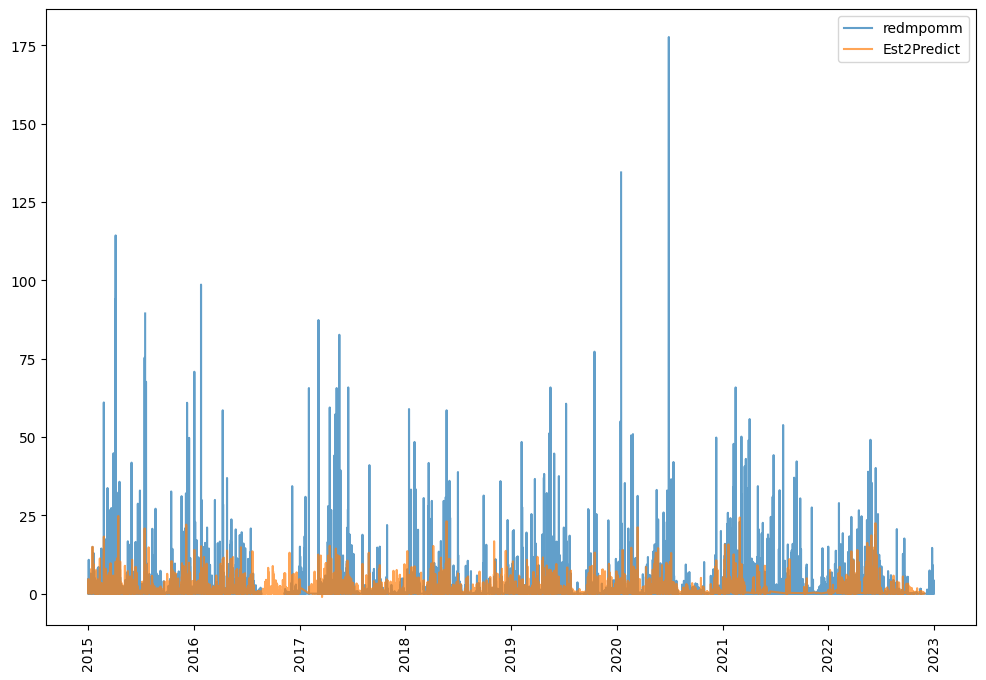

In [33]:
#comparison of station 2
fig, ax=plt.subplots(figsize=(12,8),sharex=True,sharey=True)
ax.plot(filtered_dataset.index,filtered_dataset['value'],label='redmpomm', alpha=0.7)
ax.plot(xTest.index,yPredict,label='Est2Predict', alpha=0.7)
plt.legend()
plt.xticks(rotation='vertical')
plt.show()

C:\Users\drengifo\AppData\Local\Temp\ipykernel_22020\1632493807.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\drengifo\AppData\Local\Temp\ipykernel_22020\1632493807.py:13: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.2' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.



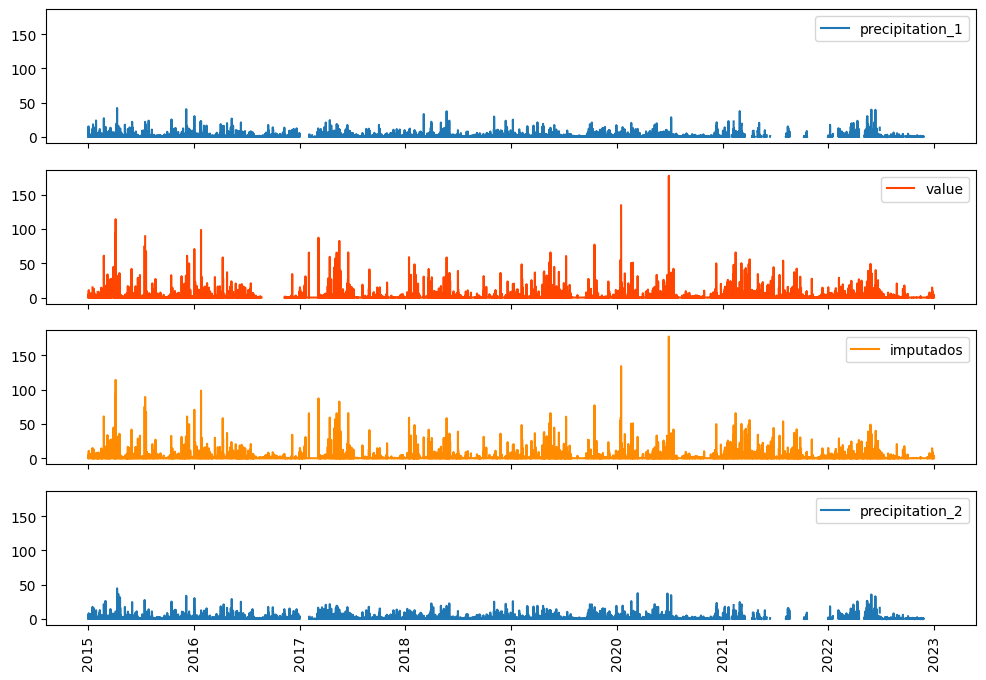

In [34]:
#create new column
filtered_dataset['imputados'] = 0
#fill the new column with original and predicted values for Est2
for index, row in filtered_dataset.iterrows():
    if np.isnan(row['value']) and ~np.isnan(row['lat_1.95_lon_-78.85']) and ~np.isnan(row['lat_1.95_lon_-78.75']):
        rowScaled = scaler.transform([[row['lat_1.95_lon_-78.85'],row['lat_1.95_lon_-78.75']]])
        prediction = regr.predict(rowScaled)
        if prediction < 0:
            filtered_dataset.loc[index,['imputados']] = 0
        else:
            filtered_dataset.loc[index,['imputados']] = regr.predict(rowScaled)
    elif ~np.isnan(row['value']):
        filtered_dataset.loc[index,['imputados']] = row['value']
    else:
        row['imputados'] = np.nan
#show original and filled values
fig, axs=plt.subplots(4,1,figsize=(12,8),sharex=True,sharey=True)
axs[0].plot(filtered_dataset.index,filtered_dataset['lat_1.95_lon_-78.85'],label='precipitation_1')
axs[0].legend()
axs[1].plot(filtered_dataset.index,filtered_dataset['value'],label='value',color='orangered')
axs[1].legend()
axs[2].plot(filtered_dataset.index,filtered_dataset['imputados'],label='imputados',color='darkorange')
axs[2].legend()
axs[3].plot(filtered_dataset.index,filtered_dataset['lat_1.95_lon_-78.75'],label='precipitation_2')
axs[3].legend()
plt.xticks(rotation='vertical')
plt.show()

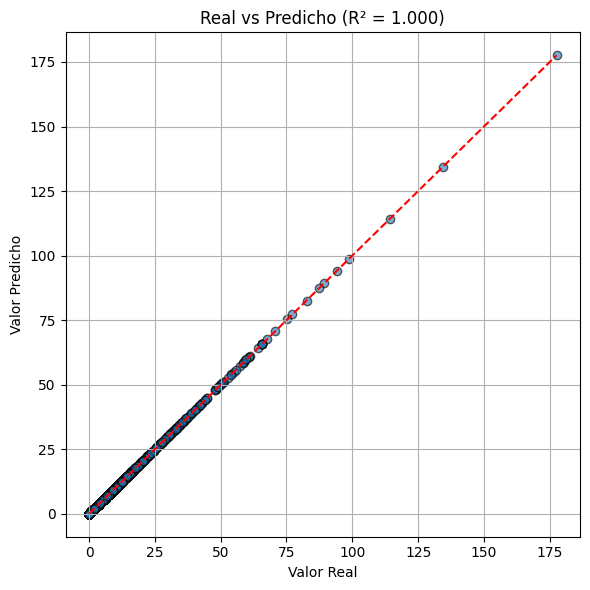

In [35]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score

# Eliminar filas con NaN en las columnas relevantes
data_clean = filtered_dataset.dropna(subset=['value', 'imputados'])

# Calcular R² solo con datos válidos
r2 = r2_score(data_clean['value'], data_clean['imputados'])

# Gráfico
plt.figure(figsize=(6, 6))
plt.scatter(data_clean['value'], data_clean['imputados'], alpha=0.6, edgecolors='k')
min_val = min(data_clean['value'].min(), data_clean['imputados'].min())
max_val = max(data_clean['value'].max(), data_clean['imputados'].max())
plt.plot([min_val, max_val], [min_val, max_val], 'r--')
plt.title(f"Real vs Predicho (R² = {r2:.3f})")
plt.xlabel("Valor Real")
plt.ylabel("Valor Predicho")
plt.grid(True)
plt.tight_layout()
plt.show()


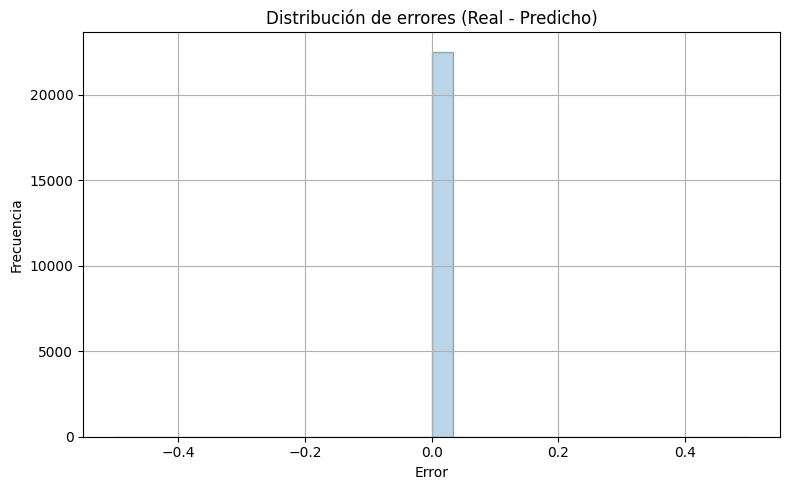

In [36]:
errors = filtered_dataset['value'] - filtered_dataset['imputados']

plt.figure(figsize=(8, 5))
plt.hist(errors, bins=30, edgecolor='black', alpha=0.3)
plt.title("Distribución de errores (Real - Predicho)")
plt.xlabel("Error")
plt.ylabel("Frecuencia")
plt.grid(True)
plt.tight_layout()
plt.show()


In [37]:
from graphics_utils.go import multi_line

fig=multi_line(original=filtered_dataset['value'], imputada=filtered_dataset['imputados'])
fig.show()

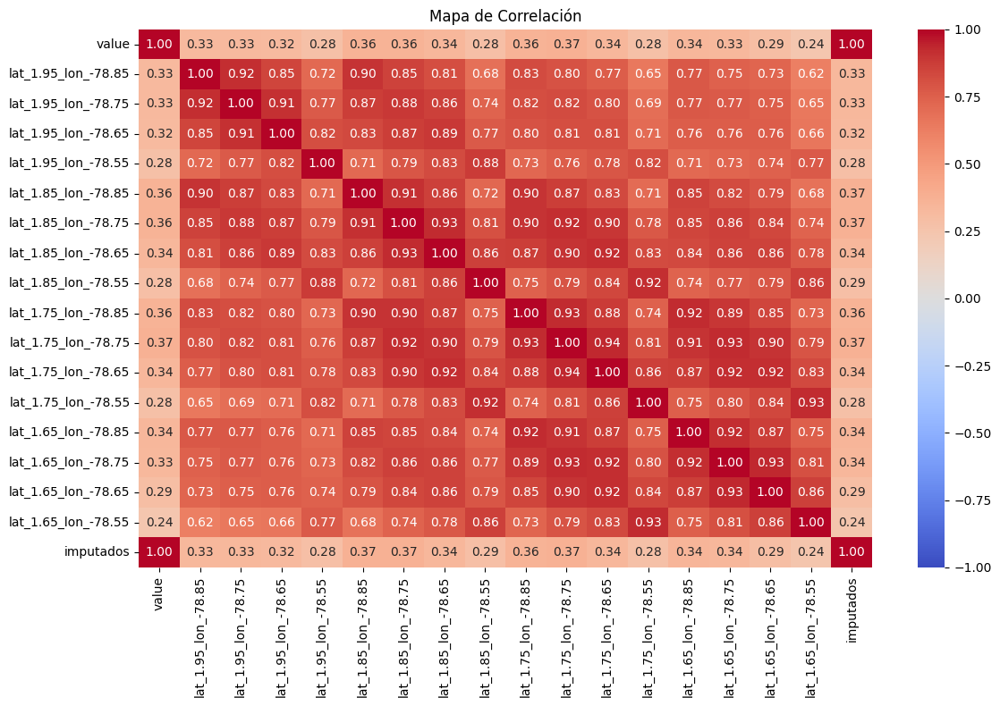

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calcular la matriz de correlación
correlation_matrix = filtered_dataset.corr()

# Crear el mapa de calor
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, fmt=".2f")

# Título y ajustes
plt.title("Mapa de Correlación")
plt.tight_layout()
plt.show()


¿Valores nulos restantes? 0


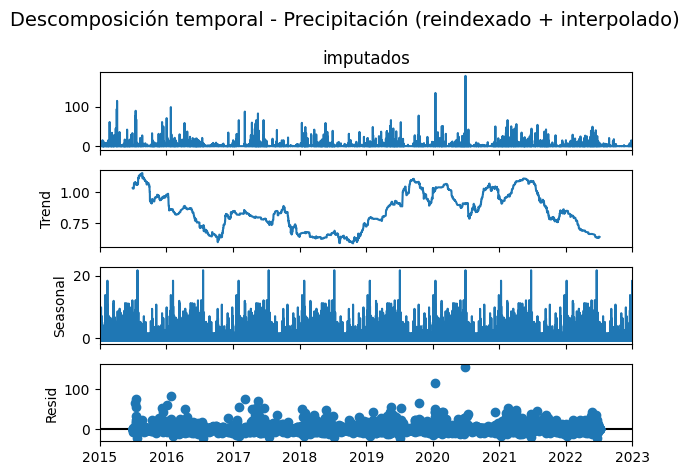

In [39]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

# 1. Selecciona la columna
precip_clean = filtered_dataset['imputados'].copy()

# 2. Convierte el índice a datetime si no lo es
precip_clean.index = pd.to_datetime(precip_clean.index)

# 3. Reindexar con frecuencia completa para evitar huecos ocultos
full_index = pd.date_range(start=precip_clean.index.min(), end=precip_clean.index.max(), freq='3h')
precip_clean = precip_clean.reindex(full_index)

# 4. Interpola para evitar NaNs
precip_clean = precip_clean.interpolate(method='linear')

# 5. Confirmar limpieza
print("¿Valores nulos restantes?", precip_clean.isna().sum())

# 6. Descomposición (usamos period=8 para ciclo diario en datos 3H)
decomposition = seasonal_decompose(precip_clean, model='additive', period=8*30*12)
decomposition.plot()
plt.suptitle("Descomposición temporal - Precipitación (reindexado + interpolado)", fontsize=14)
plt.tight_layout()
plt.show()


In [40]:
from statsmodels.tsa.seasonal import seasonal_decompose
import pandas as pd
import plotly.graph_objects as go

# 1. Selección de la columna
precip_clean = filtered_dataset['imputados'].copy()

# 2. Conversión del índice a datetime
precip_clean.index = pd.to_datetime(precip_clean.index)

# 3. Reindexar con frecuencia completa
full_index = pd.date_range(start=precip_clean.index.min(), end=precip_clean.index.max(), freq='3h')
precip_clean = precip_clean.reindex(full_index)

# 4. Interpolación para NaNs
precip_clean = precip_clean.interpolate(method='linear')

# 5. Verificar valores nulos
print("¿Valores nulos restantes?", precip_clean.isna().sum())

# 6. Descomposición
decomposition = seasonal_decompose(precip_clean, model='additive', period=8*28*9)

# 7. Visualización con Plotly
fig = go.Figure()

fig.add_trace(go.Scatter(x=precip_clean.index, y=decomposition.observed, name='Observed'))
fig.add_trace(go.Scatter(x=precip_clean.index, y=decomposition.trend, name='Trend'))
fig.add_trace(go.Scatter(x=precip_clean.index, y=decomposition.seasonal, name='Seasonal'))
fig.add_trace(go.Scatter(x=precip_clean.index, y=decomposition.resid, name='Residual'))

fig.update_layout(
    title='Descomposición Temporal - Precipitación (Plotly)',
    xaxis_title='Fecha',
    yaxis_title='Valor',
    height=600,
    legend_title='Componentes',
    template='plotly_white'
)

fig.show()


¿Valores nulos restantes? 0
